# Cellular Automata as Applied to Wildfire Modeling #
### CS577 Final Project ###
By Anthony Marcozzi

# Introduction

Researchers in the field of wildfire modeling have made exciting steps forward with full-physics couple-atmospheric fire models capable of capturing the interaction between fire and its environment. WFDS and FIRETEC are two such models capable of simulating fire dynamics in a 3D environment [(Sullivan 2009)](https://doi.org/10.1071/wf06143). However, these models are computationally expensive, difficult to validate, and data is often unavailable for use cases. As such, use of these models has largely been relegated to academic communities [(Hiers et al. 2020)](https://doi.org/10.1186/s42408-020-0070-8).

Recently, [(Linn 2020)](https://doi.org/10.1016/j.envsoft.2019.104616) published a cellular automata based fire that also captures fire-atmospheric effects while running at near real-time. The model augments standard cellular automata rules with a physical model governing wind flow and advection. 

Through this project I seek to learn more about the capabilities of cellular automata for modeling complex systems such as wildfires, and to explore cellular automata models with additional physical rules. I approach this problem in two parts. Part 1 explores a simple forest fire model which models the interaction of fire and fuels on a landscape scale. Part 2 explores two different fire models based on cellular automata. The first model represents fire spread with probability calculations of fire moving from one cell to another. The second model introduces a phenomological model of convection in the form of rising bubbles in order to simulate physical effects.

In [1]:
# Load packages
import os
import numpy as np
import matplotlib as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Load local programs
from forest_fire_model import *
from greek_model import *

# Who really knows why matplotlib throws warnings?
import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

# Part 1 - Forest Fire Model #

## Introduction ##

[(Drossel and Schawbl 1992)](https://doi.org/10.1016/0378-4371(92)90504-J) introduced the following forest fire model. In their paper, the authors claim that given certain values of $f$ and $p$ the model is in a self-organized critical state. However, it appears that this claim is under lively debate with published papers up until 2020 debating whether this holds true for different domain sizes.

## Method and Verification ##

The Forest Fire Model is defined by three simple rules:

   1) A burning tree becomes an empty site and all trees next to it become burning trees.

   2) At an empty site a tree grows with probability $p$.

   3) A tree becomes a burning tree during one time step with probability $f$ if no neighbor is burning.

Below, I demonstrate a landscape of 100x100 forest cells subject to the above CA rules.

In [2]:
# Initialize and run a forest fire model instance
landscape = ForestFireModel(100, p=0.002, f=0.00001, t=.5)
animation = landscape.animate_forest(1000, figsize=(10,10))
HTML(animation.to_jshtml())

## Analysis ##

The above plot shows landscape fire behavior consistent with the "fuel mosaic". The fuel mosaic describes the exclusion of fire from certain area due to a buffer of previously burned landscape. The patchwork-like quality of burned and unburned fuels plays an important role in regulating fire intensity, fire movement on the landscape, and ecosystem recovery [(Duncan 2015)](https://www.sciencedirect.com/science/article/pii/S0304380015003191).

Interestingly, the below plot displays a cyclical relationship between the number of unburned and burning trees. Intuitively, this makes a good deal of sense. As the number of trees increases, fire is more likely to spread through a forest cluster and decrease the density of trees. Then, trees grow in relatively safe, low-density environments until enough grow to again be at risk of large fire events. While this in of itself isn't groundbreaking science, it does suggest that CAs are capable of modeling complicated systems that are otherwise described by differential equations. In this case the CA mimics a simple predator-prey model, but can CAs also be used to mimic more complicated physical models with difficult to solve differential equations?

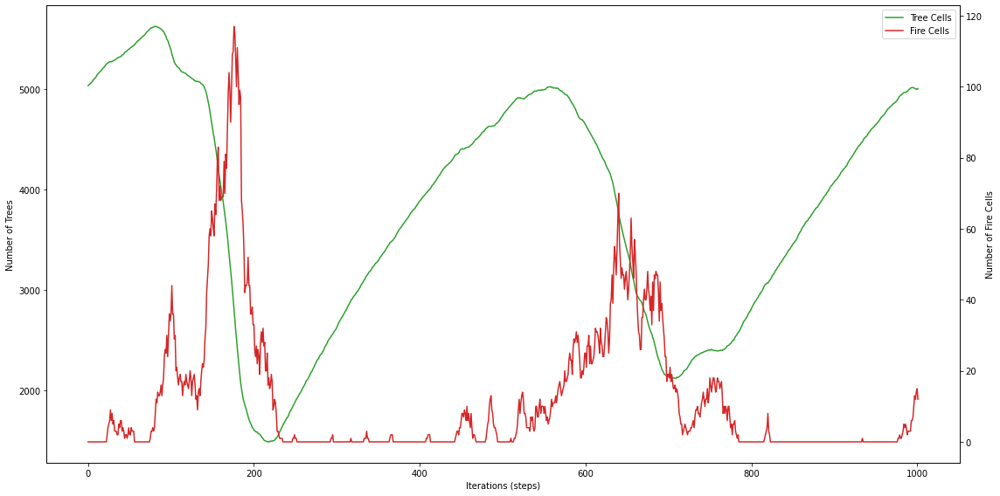

In [6]:
# Plot the number of trees vs. number of burning cells over time
landscape.plot_stats((16, 8), normalized=False)

# Part 2 - CA for Local Wildfire Events #

![Parabolic Head Fire](./images/parabolic_headfire.jpg)


# Model 1 -  CA for Forest Fire Spread Prediction #

## Introduction ##

The first model I will explore (henceforth refered to as the Greek Model) was introduced by [Alexandridis (1990)](https://doi.org/10.1016/j.amc.2008.06.046) as an attempt to use cellular automata rules to 

![figure 8](./images/greek_model_fig.jpg)


## Method ##

### CA Rules ###

The cellular automata rules governing the behavior of the model are quite similar to the rules from the Forest Fire Model. The principle difference is that fire moves from a burning cell to a neighbor based on a computed probability. The parameters of this probability are explored below.

![model_rules](./images/greek_model_rules.jpg)

### What are the probability variables? ###

$$p_{\textrm{burn}} = p_{\textrm{h}}(1 + p_{\textrm{veg}})(1+p_{\textrm{den}})p_wp_s $$

Where the type and density of vegetation are given by $p_{\textrm{veg}}$ and $p_{\textrm{den}}$. This suggests that fuel types have an intrinsc combustability represented by the probability that fire carries through the fuel, and that denser fuel beds are more likely to carry fire than sparse fuel beds. Intuitively these make sense, but are difficult to define numerically. In the paper, the authors use an optimization technique to find values for $p_{\textrm{h}}$, $p_{\textrm{veg}}$, and $p_{\textrm{den}}$. For my own implementation of the model, I use the values reported by the authors for dense pine forest vegetation.

### What is the effect of wind on the landscape? ###

$$ p_{w} = e^{c_1 V}f_{t}, \quad f_{t} = e^{V c_{2} (\cos(\theta) - 1)}$$

For wind velocity $V$, wind direction $\theta$, and constans $c_1$ and $c_2$.

### What is the effect of slope on the landscape? ###

$$ p_{s} = e^{a \theta_s} $$

For this level surface grass-fire example, the slope is zero between all cells. Thus, $p_s = 1$ and slope does not impact the probability of fire spread.

## Verification ##

Below I run a simulation with a southerly wind of 8 meters/second on a 100 meter x 100 meter domain. All fuel is assumed to be heterogenous pine of normal density. The landscape is assumed to be completely flat.

In [4]:
# Initialize the lattice
lattice_size = 100
model = GreekModel(lattice_size, 8, 90)

# Initial fuel/no fuel in the lattice
fuel_probability = 1
model.initialize_state(fuel_probability)

# Set an ignition point
ignition_point_c = [i for i in range(lattice_size//4,lattice_size-lattice_size//4)]
ignition_point_r = [lattice_size-1 for i in range(0, len(ignition_point_c))]
model.ignite_fire(ignition_point_r, ignition_point_c)

animation = model.animate(100, (12,12))
HTML(animation.to_jshtml())

## Analysis ##

A qualitiative analysis of the resulting simulation is discouraging. The fire fails to form the characteristic elipse shape that is expected in a homogenous, continuous fuel bed. Furthermore, the wind appears to be the driving force for $p_{\textrm{burn}}$. While this is certainly expected behavior, I expected the $p_{w}$ term to moderate fire spread on the flanks (sides) of the domain. However, if we examine the $p_{w}$ equation again, it is apparent that this is not the case:

$$ p_{w} = e^{c_1 V}f_{t}, \quad f_{t} = e^{V c_{2} (\cos(\theta) - 1)}$$

A graph of $p_{w}$ further demonstrates the "uniform fire line" effect.

![greek wind](./images/greek_model_wind.jpg)


# Model 2 - The Phenemological Bubble Model #

## Introduction ##

[Achtemeier (2013)](https://doi.org/10.1071/WF11055)

## Methodology ##

![bubble step one](./images/bubble_step_one.jpg)

![bubble step two](./images/bubble_step_two.jpg)

## Verification ##

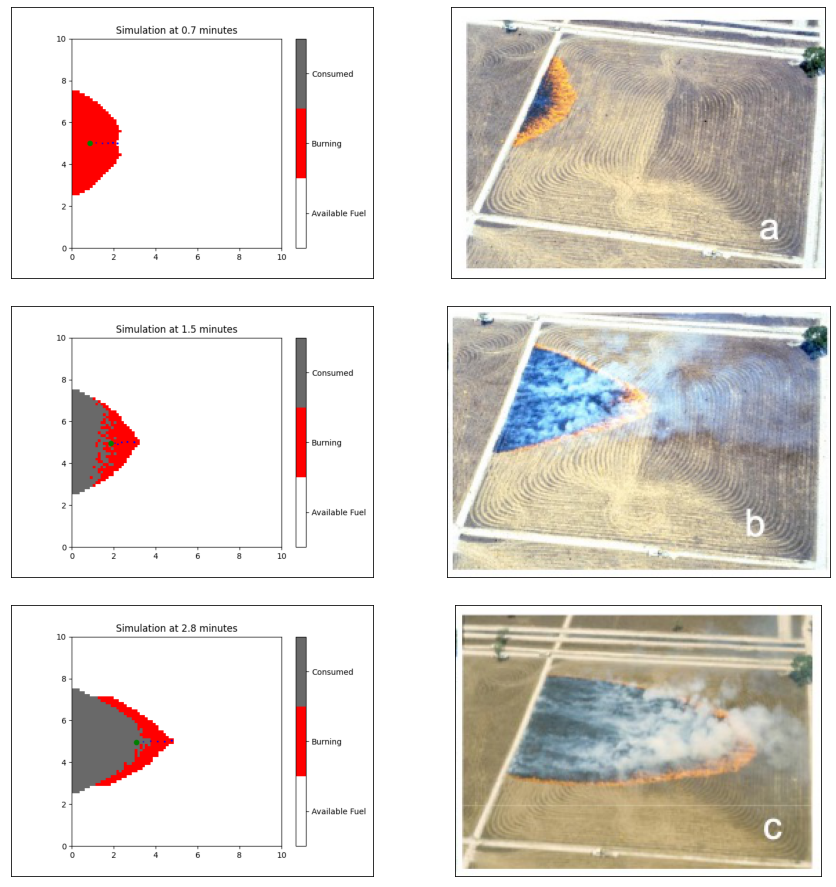

In [7]:
im_dir = './images'
fig, ax = plt.subplots(3, 2, figsize=(24,16))
model_40_seconds = plt.imread(f'{im_dir}/model_40_seconds.png')
model_100_seconds = plt.imread(f'{im_dir}/model_100_seconds.png')
model_200_seconds = plt.imread(f'{im_dir}/model_200_seconds.png')
fire_40_seconds = plt.imread(f'{im_dir}/obvs_fire_40_seconds.jpg')
fire_100_seconds = plt.imread(f'{im_dir}/obvs_fire_100_seconds.jpg')
fire_200_seconds = plt.imread(f'{im_dir}/obvs_fire_200_seconds.jpg')
ax[0,0].imshow(model_40_seconds)
ax[0,0].set_xticks([])
ax[0,0].set_yticks([])
ax[1,0].imshow(model_100_seconds)
ax[1,0].set_xticks([])
ax[1,0].set_yticks([])
ax[2,0].imshow(model_200_seconds)
ax[2,0].set_xticks([])
ax[2,0].set_yticks([])
ax[0,1].imshow(fire_40_seconds)
ax[0,1].set_xticks([])
ax[0,1].set_yticks([])
ax[1,1].imshow(fire_100_seconds)
ax[1,1].set_xticks([])
ax[1,1].set_yticks([])
ax[2,1].imshow(fire_200_seconds)
ax[2,1].set_xticks([])
ax[2,1].set_yticks([])
plt.subplots_adjust(wspace=-0.5, hspace=0.1)
fig.savefig(f'{im_dir}/bubble_comparison.png', dpi=300)
plt.show()

## Analysis ##

Unfortunately, the model does have some flaws. Firstly, increasing the time stepping reduces the effect of the convection bubble model. Because fewer bubbles are released as the fire moves, convection has less of an impact on fire behavior.

![higher dt](./images/bubble_higher_dt.png)

Secondly, the model is sensitive to the scale of the mesh. This is because the magnitude of the resulting vector from each fire cell to each bubble is scaled by the inverse of the square root of the distance between the cell and the bubble (this is why it's important that bubbles rise over time). Thus, as the distance increases due to an increase in the absolute difference in the domain, the effect of the bubble convection decreases exponentially. 

![large distance](./images/bubble_large_distance.png)

# References #

Achtemeier, G. L. (2013). Field validation of a free-agent cellular automata model of fire spread with fire - atmosphere coupling. International Journal of Wildland Fire, 22(2), 148. https://doi.org/10.1071/WF11055



Alexandridis, A., Vakalis, D., Siettos, C. I., & Bafas, G. V. (2008). A cellular automata model for forest fire spread prediction: The case of the wildfire that swept through Spetses Island in 1990. Applied Mathematics and Computation, 204(1), 191–201. https://doi.org/10.1016/j.amc.2008.06.046


Duncan, B. W., Schmalzer, P. A., Breininger, D. R., & Stolen, E. D. (2015). Comparing fuels reduction and patch mosaic fire regimes for reducing fire spread potential: A spatial modeling approach. Ecological Modelling, 314, 90–99. https://doi.org/10.1016/j.ecolmodel.2015.07.013


Drossel, B., & Schwabl, F. (1992). Self-organized criticality in a forest-fire model. Physica A: Statistical Mechanics and Its Applications, 191(1–4), 47–50. https://doi.org/10.1016/0378-4371(92)90504-J


Hiers, J. K., O’Brien, J. J., Varner, J. M., Butler, B. W., Dickinson, M., Furman, J., Gallagher, M., Godwin, D., Goodrick, S. L., Hood, S. M., Hudak, A., Kobziar, L. N., Linn, R., Loudermilk, E. L., McCaffrey, S., Robertson, K., Rowell, E. M., Skowronski, N., Watts, A. C., & Yedinak, K. M. (2020). Prescribed fire science: the case for a refined research agenda. Fire Ecology, 16(1). https://doi.org/10.1186/s42408-020-0070-8

Linn, R. R., Goodrick, S. L., Brambilla, S., Brown, M. J., Middleton, R. S., O’Brien, J. J., & Hiers, J. K. (2020). QUIC-fire: A fast-running simulation tool for prescribed fire planning. Environmental Modelling and Software, 125, 104616. https://doi.org/10.1016/j.envsoft.2019.104616


Sullivan, A. L. (2009). Wildland surface fire spread modelling, 1990 - 2007. 1: Physical and quasi-physical models. International Journal of Wildland Fire, 18(4), 349. https://doi.org/10.1071/wf06143